<a href="https://colab.research.google.com/github/pgdinamica/ianapratica/blob/main/notebooks/text_to_speech.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Parte 1 - Texto para Áudio | Speech-to-Text

## Baixando o áudio de um vídeo do YouTube

In [1]:
!pip install git+https://github.com/openai/whisper.git
!pip install yt-dlp openai

  Cloning https://github.com/openai/whisper.git to /tmp/pip-req-build-d7ktcqu1
  Running command git clone --filter=blob:none --quiet https://github.com/openai/whisper.git /tmp/pip-req-build-d7ktcqu1
  Resolved https://github.com/openai/whisper.git to commit ba3f3cd54b0e5b8ce1ab3de13e32122d0d5f98ab
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [5]:
video_url = 'https://www.youtube.com/watch?v=i6l3R7j95x8'
video_id = 'i6l3R7j95x8'

In [4]:
import yt_dlp

In [7]:
# Extrair audio usando ffmpeg
ydl_opts = {
    'format': 'bestaudio/bet',
    'postprocessors': [{
        'key': 'FFmpegExtractAudio',
        'preferredcodec': 'mp3'
    }],
    'prefer_ffmpeg': True,
    'keepvideo': False,
    'output': "%(id)s.%(ext)s"
}
ydl = yt_dlp.YoutubeDL(ydl_opts)

In [8]:
ydl.download(video_url)

[youtube] Extracting URL: https://www.youtube.com/watch?v=i6l3R7j95x8
[youtube] i6l3R7j95x8: Downloading webpage
[youtube] i6l3R7j95x8: Downloading ios player API JSON
[youtube] i6l3R7j95x8: Downloading android player API JSON
[youtube] i6l3R7j95x8: Downloading m3u8 information
[info] i6l3R7j95x8: Downloading 1 format(s): 251
[download] Destination: O que é Rede Neural Artificial ｜ Pesquisador de IA explica ｜ IA Descomplicada [i6l3R7j95x8].webm
[download] 100% of   15.36MiB in 00:00:02 at 5.38MiB/s   
[ExtractAudio] Destination: O que é Rede Neural Artificial ｜ Pesquisador de IA explica ｜ IA Descomplicada [i6l3R7j95x8].mp3
Deleting original file O que é Rede Neural Artificial ｜ Pesquisador de IA explica ｜ IA Descomplicada [i6l3R7j95x8].webm (pass -k to keep)


0

In [9]:
from IPython.display import Audio

In [10]:
Audio('O que é Rede Neural Artificial ｜ Pesquisador de IA explica ｜ IA Descomplicada [i6l3R7j95x8].mp3')

In [ ]:
#!yt-dlp -x -f bestaudio --audio-format mp3 -o "%(id)s.%(ext)s" $video_url

## Transcrição de textos em Português com whisper (OpenAI)

## Modelos disponíveis

Você pode escolher qual o tamanho de modelo deseja usar. Os tamanhos impactam na qualidade do resultado e no tempo de processamento (quanto melhor a qualidade, mais tempo de processamento). A escolha entre eles também está à qualidade do áudio: se poluído com ruídos, provavelmente será necessário um modelo com maior qualidade para conseguir transcrever corretamente.

A lista de possíveis modelos é, do mais rápido para o fim o maior qualidade:

- tiny
- base
- small
- medium
- large

In [11]:
import whisper

In [4]:
model_options = ['tiny','small', 'medium', 'large']
model_option = model_options[2]

In [13]:
model = whisper.load_model(model_option)
result = model.transcribe('O que é Rede Neural Artificial ｜ Pesquisador de IA explica ｜ IA Descomplicada [i6l3R7j95x8].mp3')
video_transcription = result['text']

100%|█████████████████████████████████████| 1.42G/1.42G [00:40<00:00, 37.3MiB/s]


In [14]:
#imprimir e escrever transcrição em arquivo .txt
print(f'==>Transcrição do vídeo: {video_id} - Utilizando modelo: {model_option} <==\n')

with open(f'{video_id}-{model_option}.txt', "w") as result_text_file:
  for sentence in video_transcription.split('.'):
    print(sentence)
    result_text_file.write(sentence)
    result_text_file.write('\n')

==>Transcrição do vídeo: i6l3R7j95x8 - Utilizando modelo: medium <==

 No Yaris Complicada de hoje, você vai aprender o que são redes neurais, vai ter uma ideia de como as redes neurais funcionam e também de porque elas são tão poderosas
 Por que nós utilizamos redes neurais para fazer aplicações que vão desde identificar pessoas e contar objetos, até mesmo a gerar textos, imagens e vídeos de alta qualidade
 Fala pessoal, eu sou o Alisson e esse é o canal Programação Dinâmica
 Se você caiu aqui de paraquedas, seja bem-vindo
 Aqui é um espaço em que eu e a Kize ensinamos e discutimos sobre programação, ciência de dados, inteligência artificial e também o impacto de novas tecnologias na sociedade
 E hoje a gente vai falar sobre redes neurais artificiais
 A ideia do Yaris Complicada é trazer uma explicação que seja acessível sobre inteligência artificial, mas que não seja superficial, de modo que você possa realmente aprender algo além do que você encontra na mídia, nos jornais, do que as

# Parte 2 -  Texto para Áudio | Text-to-Speech

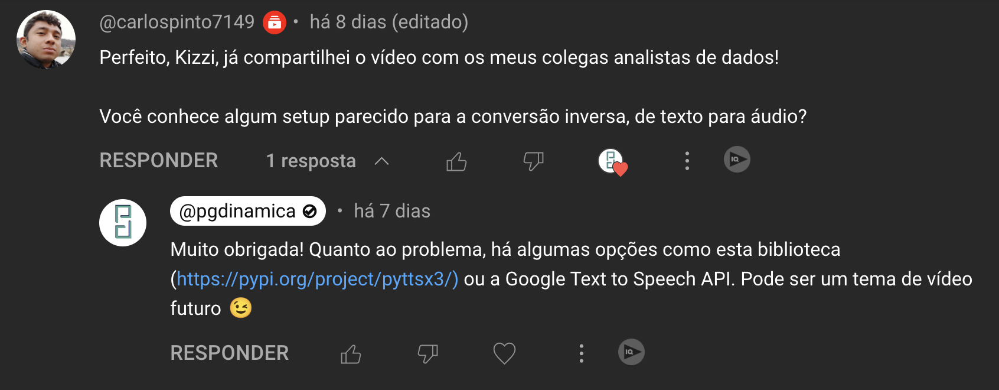

In [1]:
!pip install gTTS

In [2]:
from gtts import gTTS

In [6]:
#Ler texto do arquivo
with open(f'{video_id}-{model_option}.txt', "r") as text_file:
    transcription = text_file.read()
#print(audio_transcription)

In [7]:
tts = gTTS(transcription, lang ="pt" ,tld="com.br")
gtts_audio_file = f'{video_id}-gtts.mp3'
tts.save(gtts_audio_file)

In [9]:
from IPython.display import Audio

In [10]:
Audio(gtts_audio_file)

Pacotes Python utilizados:

https://openai.com/research/whisper

https://pypi.org/project/openai-whisper/

https://pypi.org/project/yt-dlp/

https://pypi.org/project/gTTS/

https://gtts.readthedocs.io/en/latest/module.html#localized-accents
